# **Image Stitching**:

This project aims to concisely explain and demonstrate the process of image stitching and generalize the process to N sequential images.

As we remember, image stitching is the process of fusing multiple images together that differ with their view of the scene. The culmination of these images yield a panoroama.


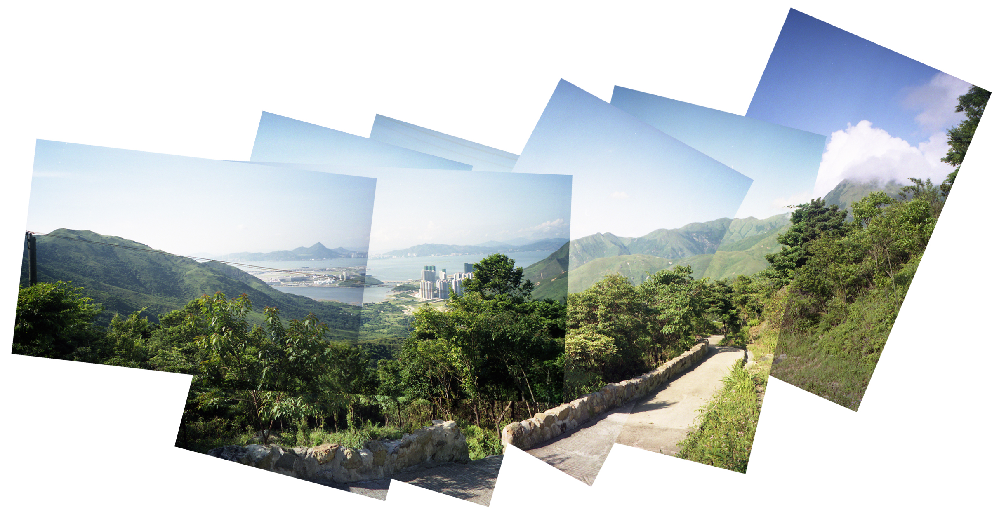

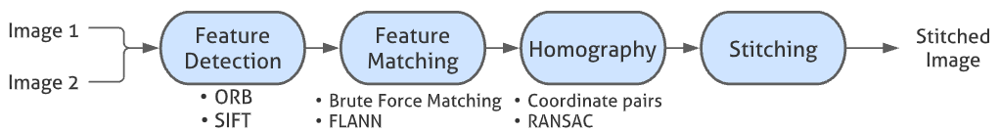

1. Feature Detection: Mason Corey
2. Feature Matching: Andrew Yung
3. Homography: Ryan Gujardo
4. Stiching & Alternative methods: Sansar Yogi

##Load Images & Dependencies

In [ ]:
def upload_files():
  from google.colab import files
  uploaded = files.upload()
  for k, v in uploaded.items():
    open(k, 'wb').write(v)
  return list(uploaded.keys())

#Images already in content/sample_data
#Andrew

In [ ]:
# SIFT Dependencies 
import sys
if 'google.colab' in sys.modules:
    import subprocess
    subprocess.call("pip install -U opencv-python".split())
    subprocess.call("wget https://raw.githubusercontent.com/YoniChechik/AI_is_Math/master/c_08_features/left.jpg".split())
    subprocess.call("wget https://raw.githubusercontent.com/YoniChechik/AI_is_Math/master/c_08_features/right.jpg".split())

#Andrew

In [ ]:
#Load Dependencies
import numpy as np
import pandas as pd
import cv2
import os
import skimage
from PIL import Image
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow
from skimage.feature import match_descriptors, plot_matches
from numpy.linalg import eig

#Andrew

In [ ]:
#Load Photos
from google.colab.files import upload
from google.colab import drive
drive.mount('/content/gdrive')
folder = '/content/gdrive/Shareddrives/278 Images/278_Images/ColorRoof'

imgs = []
max_images = 4
curr_num_images = 0
for filename in sorted(os.listdir(folder)):
  if curr_num_images < max_images:
    img = cv2.imread(os.path.join(folder,filename))
    if img is not None:
        imgs.append(img)
  curr_num_images += 1
imgs = np.array(imgs)

#Andrew/Mason

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


#**Feature Detection**

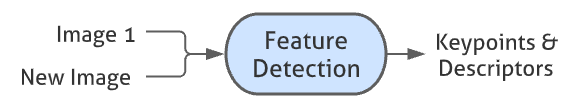
Feature Detection is comprised of two main parts:

1.   Keypoint Detection
2.   Keypoint Description



##Keypoint Detection

Keypoints are detected by looking for edges and corners using corner/edge detectors, such as the Hessian and Harris Detectors







General keypoint structure:

*   Position (x and y)
*   Size (Diameter of patch)
*   Response strength


Popular Keypoint Detector Algorithms:


*   SIFT (Licensed, generally most accurate)
*   FAST (Open Source)
*   ORB  (Improvement upon FAST, also open source. The fastest algorithm)
*   SURF (Middle ground in performance/speed compared to SIFT and ORB)



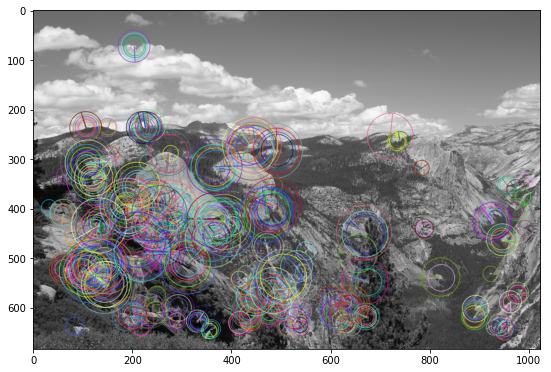

##Keypoint Description

Each keypoint must have a means of comparing its similarity to other keypoints. This is done through a keypoint descriptor (a.k.a. feature vector)

Keypoint Descriptors are generated by recording the gradients of many sub-regions within the neighboring patch of pixels and putting them all into a "feature vector". The feature vectors of two keypoints can be compared to eachother easily using simple distance calculations, which allows for efficient keypoint matching

Popular Keypoint Description Algorithms: 

*   SIFT
*   ORB
*   SURF
*   BRIEF
*   BRISK



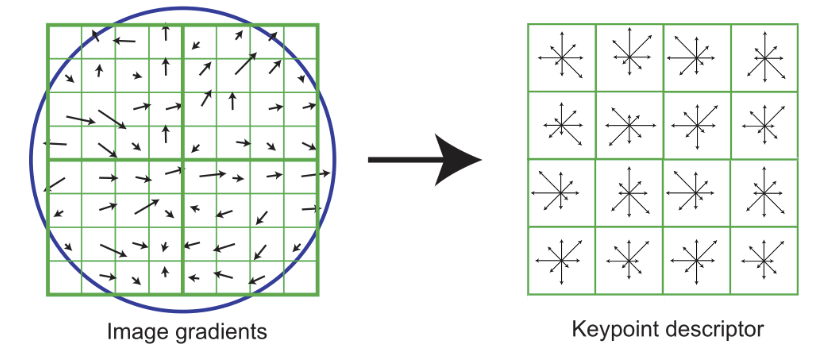

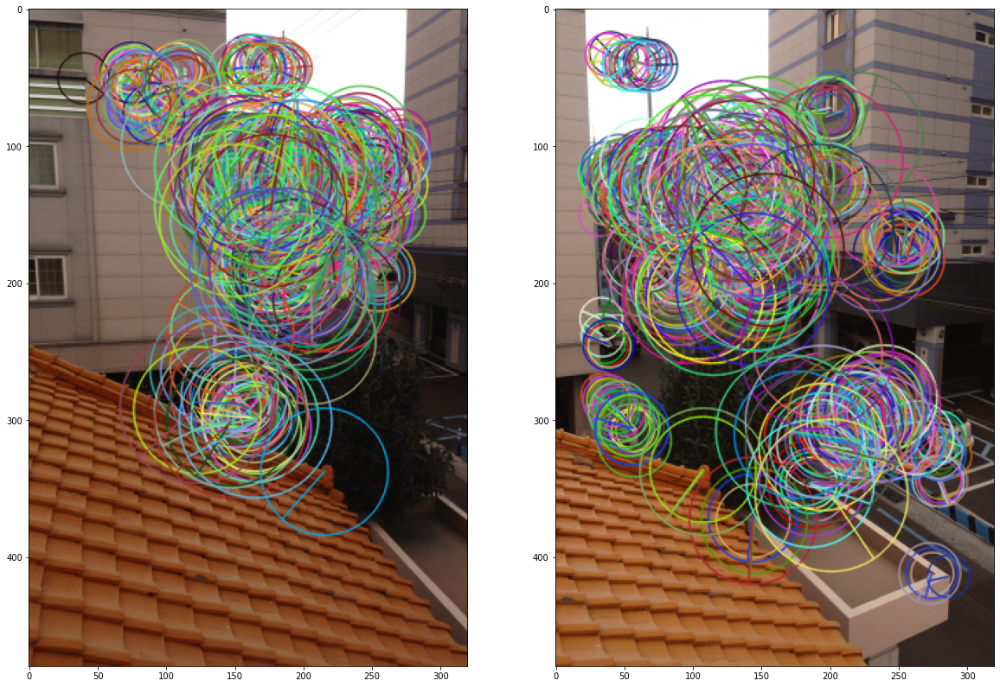

In [ ]:
def feature_detect(img1, img2):
  # Initiate SIFT detector
  orb = cv2.ORB_create()

  # find the keypoints and descriptors with SIFT
  kp1, desc1 = orb.detectAndCompute(img1,None)
  kp2, desc2 = orb.detectAndCompute(img2,None)

  # Create a subplot of N images and show them side by side
  fig, axs = plt.subplots(1, 2, figsize=(20, 20))

  img1_w_kps = cv2.drawKeypoints(img1, kp1, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
  img2_w_kps = cv2.drawKeypoints(img2, kp2, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

  axs[0].imshow(img1_w_kps)
  axs[1].imshow(img2_w_kps)

  plt.show()

  return kp1, desc1, kp2, desc2

kp1, desc1, kp2, desc2 = feature_detect(imgs[0],imgs[1])
#Mason

#**Feature Matching**
<center>

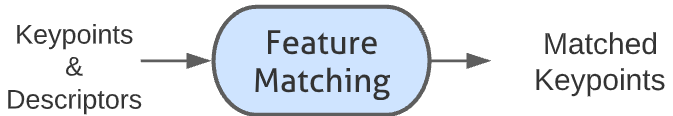

Matching Methods:
- **Brute Force Matching**: Compares the error of a descriptor in image 1 between all of the descriptors in image 2 and selects the descriptor in image 2 with the lowest euclidean distance
- **Fast Library for Approximate Nearest Neighbors (FLANN)**: Reduce the dimensionality of the descriptor to a lower discriminant dimensional space and use the hamming distance to represent the error

*Hamming distance*: 0111-1100 = 3

---

Match Filtering: \\
- **Lowe Ratio Test**: Compares errors/distances between the of best matches errors are sufficiently different. i.e. $\frac{\text{error 2nd}}{\text{error 1st}} < threhold$ 

<left> If the two best errors are too similar in value w.r.t their ratio we discard the match

**Random Sample Consensus (RANSAC)**: 
1. Randomly select a minimal subset of the matches to fit our model
2. With the model defined, count the number of inliers and outliers by thresholding w.r.t a maximum error
3. Iterate K times until we have enough inliers

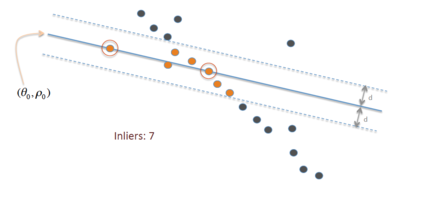

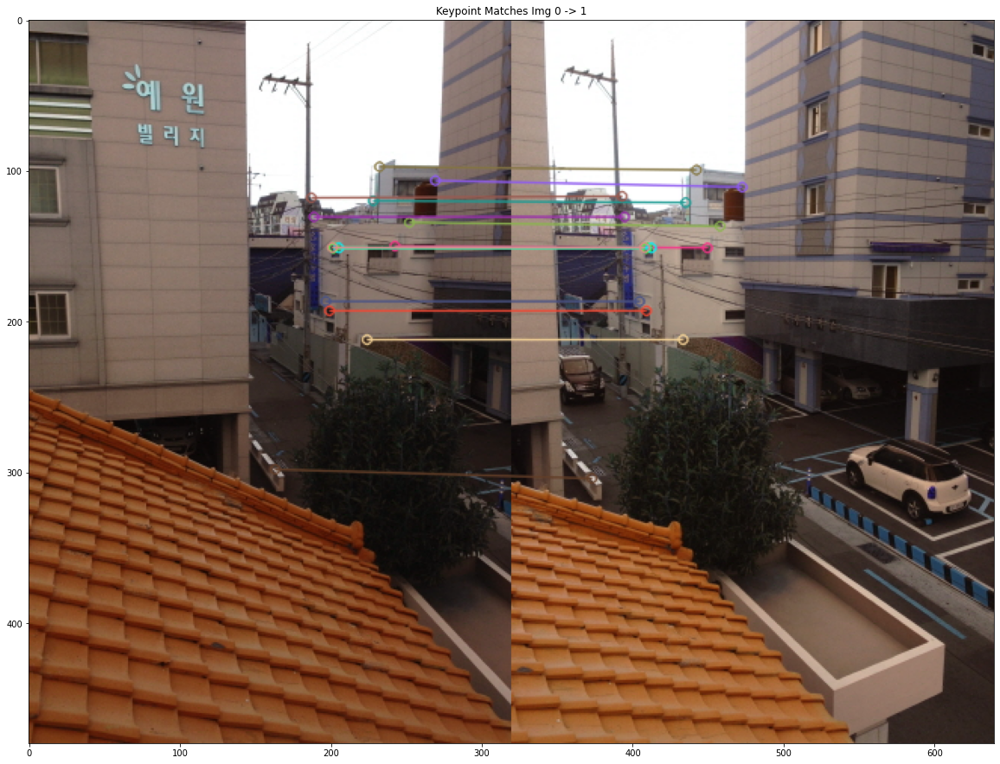

In [ ]:
def feature_match(img1, kp1, desc1, img2, kp2, desc2):
  # create BFMatcher object
  bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

  # Match descriptors.
  matches = bf.match(desc1, desc2)

  # Sort them in the order of their distance.
  matches = sorted(matches, key = lambda x:x.distance)
  
  # Draw first 10 matches.
  img_matches = cv2.drawMatches(img1, kp1, img2, kp2, matches[:15], flags=2, outImg=None)
  plt.figure(figsize=(20, 20))
  plt.imshow(img_matches)
  plt.title("Keypoint Matches Img 0 -> 1")
  plt.show()

  return matches

matches = feature_match(imgs[0],kp1,desc1,imgs[1],kp2,desc2)
#Andrew

#**Homography Mapping**
Ryan 

<center>


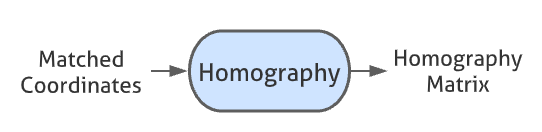

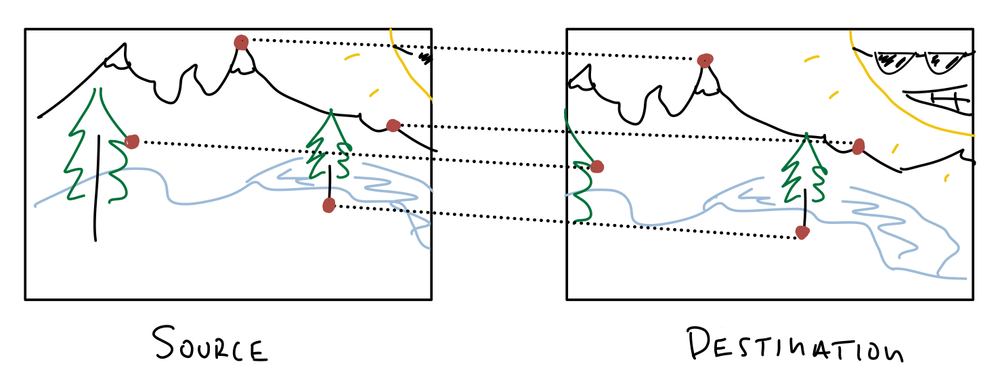

By this point we have a source image and a destination image, with a good set of matched keypoints between the images.
\
\
Homography mapping allows us to relate different images to a singular plane, through a homography matrix.


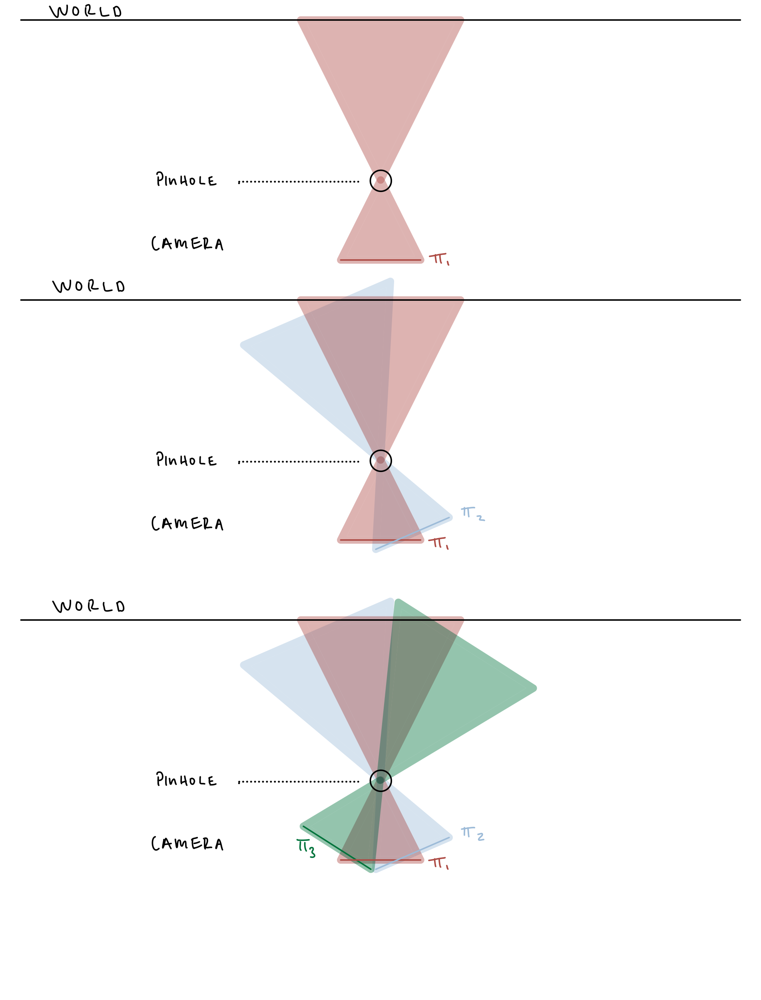

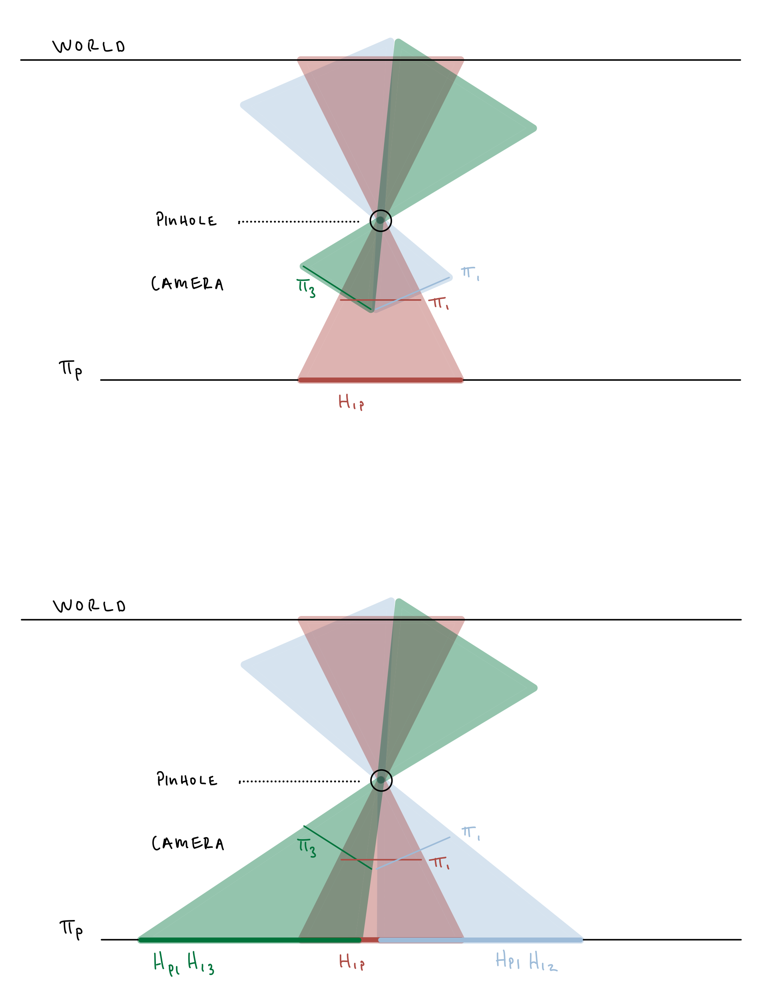

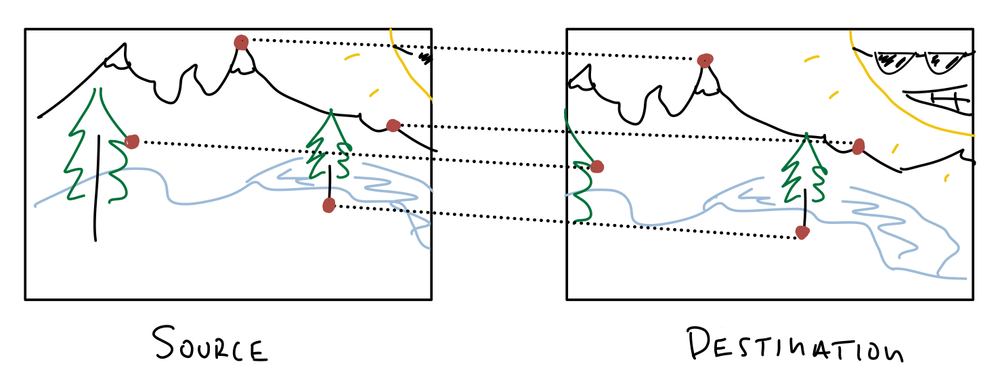








We can describe the relationship between the two images as...
\
\
\begin{align*}
        \overbrace{
        \begin{bmatrix}
        x_d\\
        y_d\\
        1
        \end{bmatrix}}^\text{Destination Image}\equiv
        \begin{bmatrix}
        \tilde{x_d}\\
        \tilde{y_d}\\
        \tilde{z_d}
        \end{bmatrix}=
        \underbrace{
        \begin{bmatrix}
        h_{11},h_{12},h_{13}\\
        h_{21},h_{22},h_{23}\\
        h_{31},h_{32},h_{33}\\
        \end{bmatrix}}_H
        \overbrace{
        \begin{bmatrix}
        x_s\\
        y_s\\
        1
        \end{bmatrix}
        }^\text{Source Image}
        \end{align*}
\
We have 9 unknowns but 8 D.O.F.
\
\
How many pairs of points do we need?.....4 bare minimum!
\
\
However we don't want to use just 4 pairs, we want to use all of our matched pairs for a better estimate of the homography.

\
\begin{align*}
  \tilde{x_d} = h_{11}x_s + h_{12}y_s +h_{13}
  \\
  \tilde{y_d} = h_{21}x_s + h_{22}y_s + h_{23}
  \\
  \tilde{z_d} = h_{31}x_s + h_{32}y_s + h_{33}
  \\
  \end{align*}

  \
\begin{align*}
  x_d^{i}= \frac{\tilde{{x_d}^{i}}}{\tilde{z_d^{i}}} \rightarrow \tilde{z_d^{i}}x_d^{i}= \tilde{x_d^{i}} 
  \newline
  y_d^{i}= \frac{\tilde{{y_d}^{i}}}{\tilde{z_d^{i}}} \rightarrow \tilde{z_d^{i}}y_d^{i}= \tilde{y_d^{i}}  
  \end{align*}
  \
  Where superscript $i$ represents the index for the pair of points...
  \
  \
\begin{align*}
  (h_{31}x_s^{i} + h_{32}y_s^{i} + h_{33})\,\,(\tilde{x_d^{i}}) = h_{11}x_s^{i} + h_{12}y_s^{i} +h_{13} 
\newline
   (h_{31}x_s^{i} + h_{32}y_s^{i} + h_{33})\,\,(\tilde{y_d^{i}}) =  h_{21}x_s^{i} + h_{22}y_s^{i} + h_{23}
\end{align*}

\
Writing in matrix form for a single pair of points, we get...
  

  \begin{align}
        \begin{bmatrix}
        x_s^{i} & y_s^{i} & 1 & 0 & 0 & 0 &-x_d^{i}x_s^{i} & -x_d^{i}y_s^{i} & -x_d^{i}\\
        0&0&0&x_s^{i} & y_s^{i} & 1 &-y_d^{i}x_s^{i}&-y_d^{i}y_s^{i}&-y_d^{i}
        \end{bmatrix}
        \begin{bmatrix}
        h_{11}\\
        h_{12}\\
        h_{13}\\
        h_{21}\\
        h_{22}\\
        h_{23}\\
        h_{31}\\
        h_{32}\\
        h_{33}\\
        \end{bmatrix}=
        \begin{bmatrix}
        0\\
        0
        \end{bmatrix}
    \end{align}

\
Although in general we can solve this with 4 pairs  would much prefer to have an overdetermined system to find the best homography...
\
We combine the equations for all the other point pairs...
\
\
  \begin{align}
        \underbrace{
        \begin{bmatrix}
        x_s^{1} & y_s^{1} & 1 & 0 & 0 & 0 &-x_d^{1}x_s^{1} & -x_d^{1}y_s^{1} & -x_d^{1}\\
        0&0&0&x_s^{1} & y_s^{1} & 1& -y_d^{1}x_s^{1}&-y_d^{1}y_s^{1}&-y_d^{1}\\
        &&&&\vdots\\
        x_s^{i} & y_s^{i} & 1 & 0 & 0 & 0 &-x_d^{i}x_s^{i} & -x_d^{i}y_s^{i} & -x_d^{i}\\
        0&0&0&x_s^{i} & y_s^{i} & 1& -y_d^{i}x_s^{i}&-y_d^{i}y_s^{i}&-y_d^{i}\\
        &&&&\vdots\\
        x_s^{n} & y_s^{n} & 1 & 0 & 0 & 0& -x_d^{n}x_s^{n} & -x_d^{n}y_s^{n} & -x_d^{n}\\
        0&0&0&x_s^{n} & y_s^{n} & 1 &-y_d^{n}x_s^{n}&-y_d^{n}y_s^{n}&-y_d^{n}\\
        \end{bmatrix}}_\text{A, known}\quad
        \underbrace{
        \begin{bmatrix}
        h_{11}\\
        h_{12}\\
        h_{13}\\
        h_{21}\\
        h_{22}\\
        h_{23}\\
        h_{31}\\
        h_{32}\\
        h_{33}\\
        \end{bmatrix}}_\text{h, unknown}=
        \begin{bmatrix}
        0\\
        0\\
        \vdots\\
        0\\
        0\\
        \vdots\\
        0\\
        0\\
        \end{bmatrix}
    \end{align}

So we have the equation we want to solve...

\begin{align*}
Ah=0
\end{align*}

We have a trivial solution of $h = 0$, so we add a constraint on $h$...


\begin{align*}
\| \mathbf{h} \|^2 = 1
\end{align*}




\begin{align*}
\end{align*}


\
\
So we have our equation to solve:
\begin{align*}
Ah = 0\quad \mid\quad \| \mathbf{h} \|^2 = 1
\end{align*}
\
\
We can solve this using Constrained Least Squares...
\begin{align*}
\newline
.
\newline
.
\newline
.
\newline
.
\newline
.
\newline
\end{align*}

Define a Least Squares Problem:
\begin{align*}
\min_{h}\| \mathbf{Ah} \|^2 = 0 \quad\mid\quad \| \mathbf{h} \|^2 = 1
\
\newline
\newline
\min_{h}\,( \mathbf{h^TA^TAh})  = 0 \quad\mid\quad  \mathbf{h^Th}  = 1
\end{align*}
\
\
Defining our Loss Function $L(\lambda,h)$:
\begin{align*}
L(\lambda,h)=h^TA^TAh-\lambda(h^Th-1)
\end{align*}
\
\
Take Derivative of $L(\lambda,h)$ with respect to h and set equal to zero...
\
\
\begin{align*}
\frac{dL(h,\lambda)}{dh}=0
\end{align*}
\begin{align*}
\vdots
\end{align*}

\begin{align*}
A^T A h=\lambda h \quad\text{The eigenvalue problem!}
\end{align*}
\
\
To finish we solve this problem, find the smallest eigenvalue $\lambda$, and it's corresponding eigenvector $h$ is our homography matrix in vector form. 







    

Did this by hand, but ended up using cv2.findHomography().. :

:[

It has RANSAC Built in. :]

In [ ]:

# MIN_FEATURES = round(len(good_kp_l)/2)

# x_s = []
# y_s = []
# x_d = []
# y_d = []

# x_s = good_kp_l[:MIN_FEATURES,0]
# y_s = good_kp_l[:MIN_FEATURES,1]
# x_d = good_kp_r[:MIN_FEATURES,0]
# y_d = good_kp_r[:MIN_FEATURES,1]



  #check lengths
# print(len(x_s))
# print(len(y_s))
# print(len(x_d))
# print(len(y_d))

# p1 = good_kp_l;
# p2 = good_kp_r;


# A = []
# for i in range(MIN_FEATURES):
#     x, y = p1[i][0], p1[i][1]
#     u, v = p2[i][0], p2[i][1]
#     A.append([x, y, 1, 0, 0, 0, -u*x, -u*y, -u])
#     A.append([0, 0, 0, x, y, 1, -v*x, -v*y, -v])

# A = np.asarray(A)
# U, S, Vh = np.linalg.svd(A)
# L = Vh[-1,:] / Vh[-1,-1]
# H = L.reshape(3, 3)


#starting with the first pairs of points
# A = []
# A = np.array(A)

# for i in range(NUM_FEATURES):
#   print(i)
#   if A.all():
#     A = np.array(
#       [[x_s[i], y_s[i], 1,  0,   0,   0, -x_d[i]*x_s[i], -x_d[i]*y_s[i], -x_d[i]],
#       [  0,   0, 0,  x_s[i], y_s[i], 1, -y_d[i]*x_s[i], -y_d[i]*y_s[i], -y_d[i]]]
#       )
#   else:
#     B = np.array(
#       [[x_s[i], y_s[i], 1,  0,   0,   0, -x_d[i]*x_s[i], -x_d[i]*y_s[i], -x_d[i]],
#       [  0,   0, 0,  x_s[i], y_s[i], 1, -y_d[i]*x_s[i], -y_d[i]*y_s[i], -y_d[i]]]
#       )

#     A = np.vstack((A, B))

# print('A looks like \n')
# print(A)


# #get eigenvalues of Atranspose A, solve least linear squares.
# C = A.transpose() @ A
# w,v=eig(C)

# # get the index of the minimum eigenvalue, the smallest eigenvalue corresponds to
# # the h vector that we require.
# minpos = np.where(w == min(w))

# print('The smallest eigenvalue resides in')
# print(minpos)
# print('\n')
# print('The eigenvalue associated with this index is')
# print(w[minpos])
# print('\n')
# print('The eigenvector associated with this index is')
# print(v[minpos])
# print('\n')

# ## assign the vector h to the eigenvector with smallest eigenvalue.
# h = v[minpos]

# # assemble the homography matrix from h
# H = np.array([
              
#     [ h[0,0], h[0,1], h[0,2] ],
#     [ h[0,3], h[0,4], h[0,5] ],
#     [ h[0,6], h[0,7], h[0,8] ]
    
# ])

# H


In [ ]:
def compute_homography(kp1, kp2, matches):
  src_pts = np.float32([ kp1[m.queryIdx].pt for m in matches ]).reshape(-1,1,2)
  dst_pts = np.float32([ kp2[m.trainIdx].pt for m in matches ]).reshape(-1,1,2)

  H, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC,5.0)

  return H

#**Stitching - Warping and Blending**

<center>


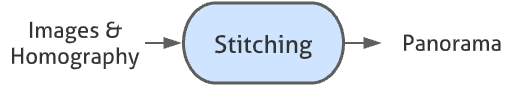



After generating the transformation matrices (homographies) for each image, we just need to apply them to the images and then stitch them all together in the reference frame using a technique called warping. \\

The code below shows how the technique works for two images. 

If desired, one can also blend the image being added on to the panorama (using feathering or pyramid blending) but this can be risky due to the warping of the new image. 

In [ ]:
#@title
def warpTwoImages(img1, img2, H):
    '''warp img2 to img1 with homograph H
    from: https://stackoverflow.com/questions/13063201/how-to-show-the-whole-image-when-using-opencv-warpperspective
    '''
    #First, find the corner coordinates of each image
    h1, w1 = img1.shape[:2]
    h2, w2 = img2.shape[:2]
    pts1 = np.float32([[0, 0], [0, h1], [w1, h1], [w1, 0]]).reshape(-1, 1, 2)
    pts2 = np.float32([[0, 0], [0, h2], [w2, h2], [w2, 0]]).reshape(-1, 1, 2)

    #Transform the coordinates of the second using the homography 
    pts2_ = cv2.perspectiveTransform(pts2, H)
    pts = np.concatenate((pts1, pts2_), axis=0)
    [xmin, ymin] = np.int32(pts.min(axis=0).ravel() - 0.5)
    [xmax, ymax] = np.int32(pts.max(axis=0).ravel() + 0.5)
    t = [-xmin, -ymin]
    Ht = np.array([[1, 0, t[0]], [0, 1, t[1]], [0, 0, 1]])  # Translation Matrix

    #First display the 2nd image, warped onto 1st image plane - Then add the 1st:
    result = cv2.warpPerspective(img2, Ht@H, (xmax-xmin, ymax-ymin))
    result[t[1]:h1+t[1], t[0]:w1+t[0]] = img1

    #cropped_result = result[-ymin:ymax,:,:]

    plt.figure(figsize=(10, 10))
    plt.imshow(result)
    plt.title("Warped Result, No Blending")
    plt.show()

    return result

#**Full Pipeline**



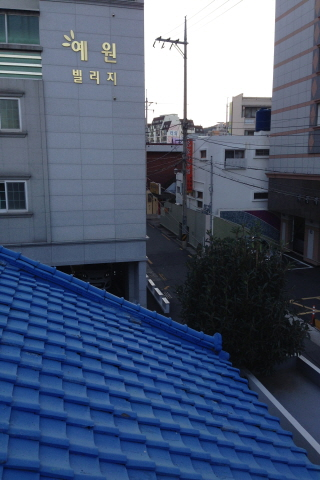

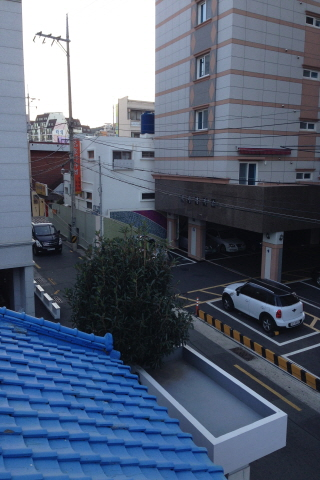

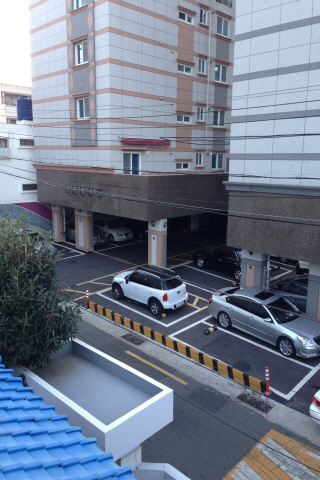

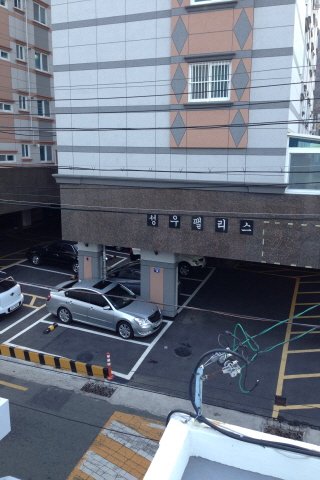

In [ ]:
N,row,col,_  = imgs.shape

for i in range(N):
  cv2_imshow(imgs[i])

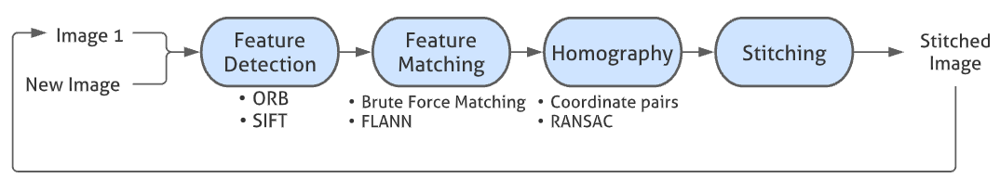

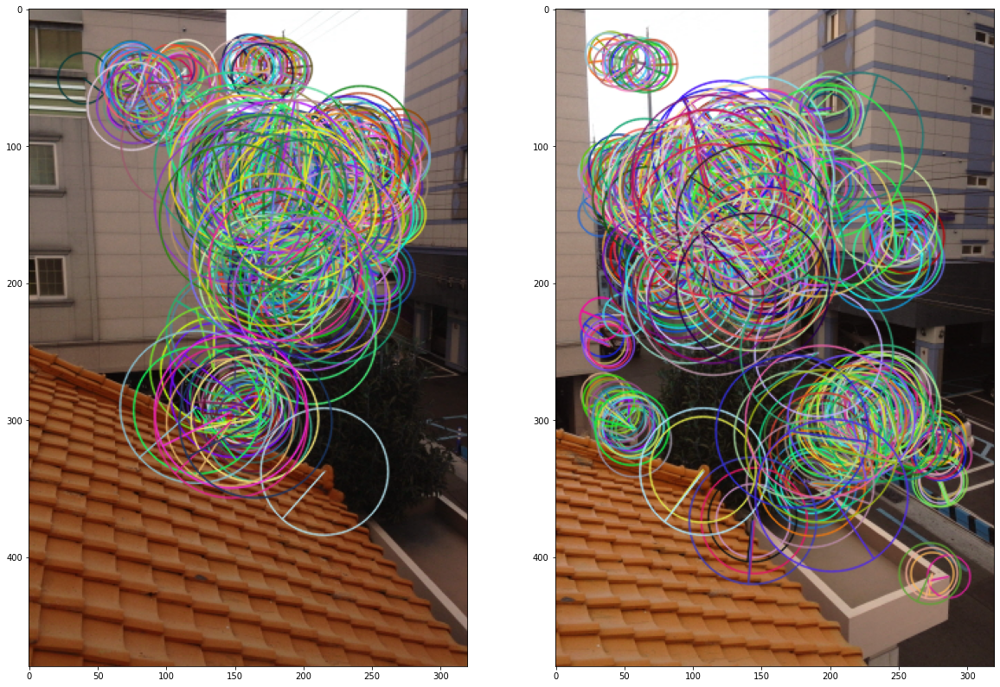

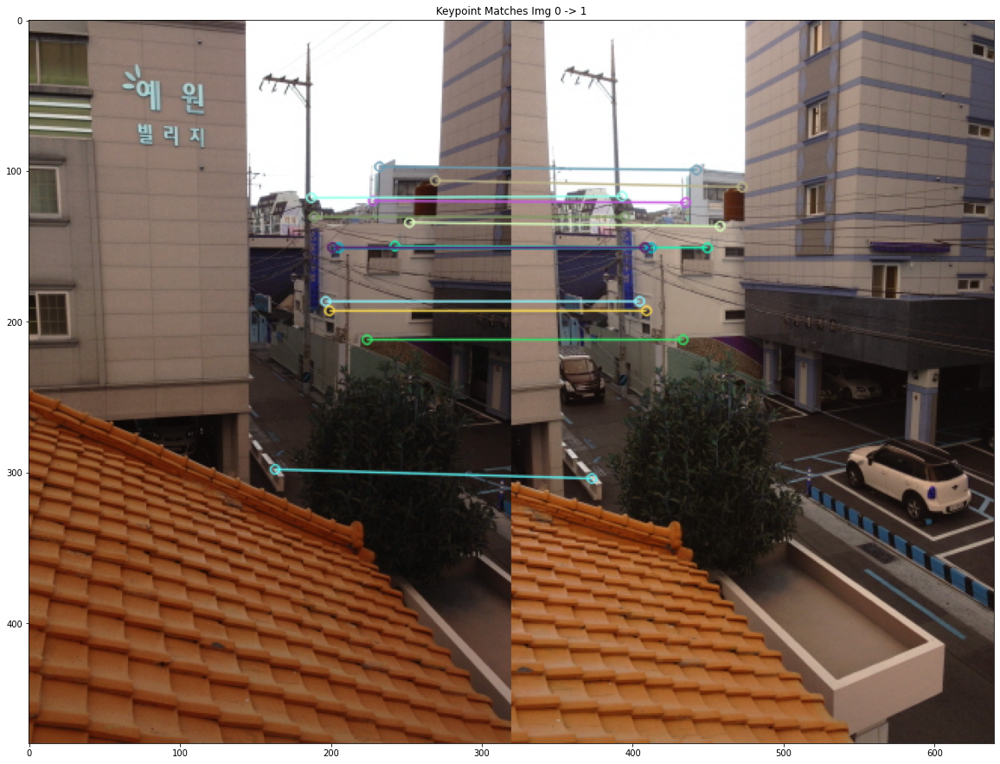

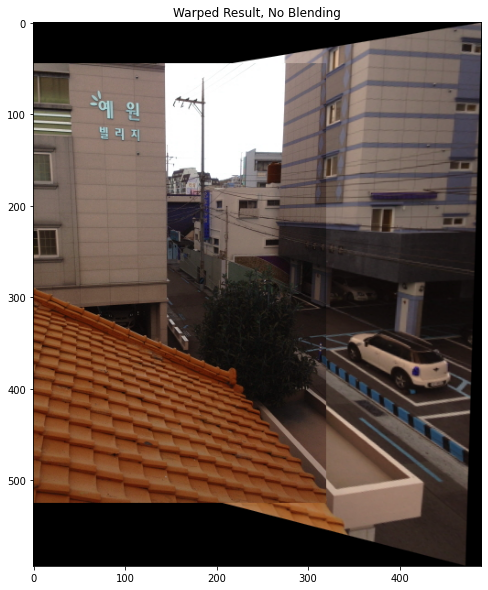

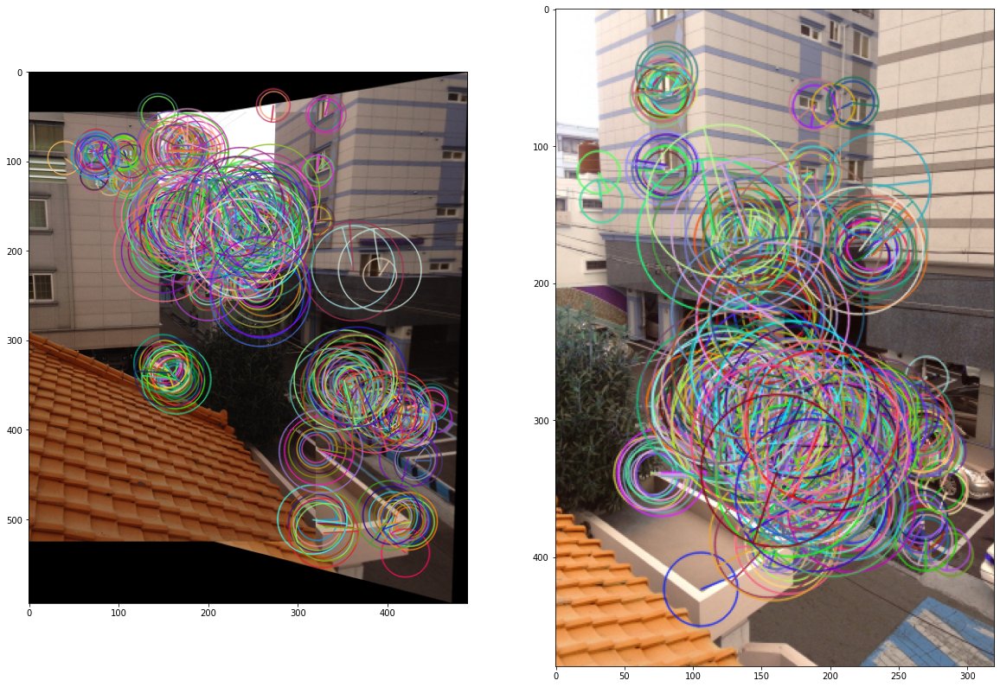

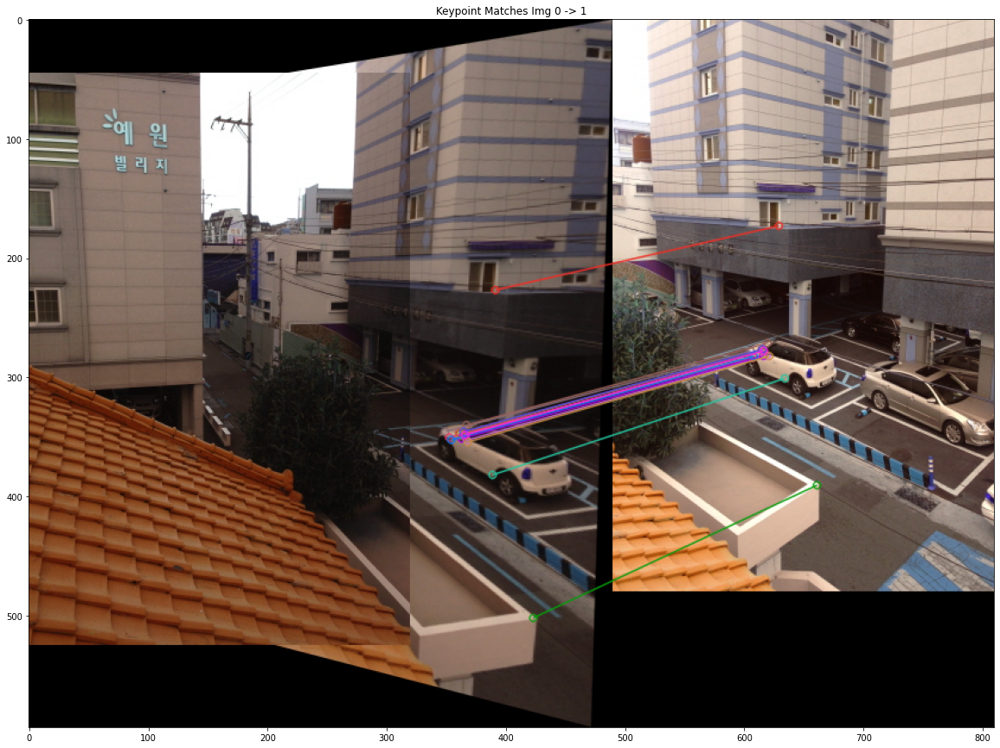

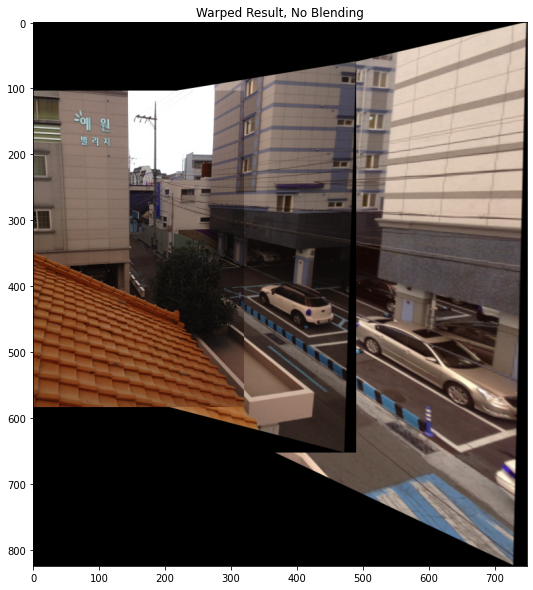

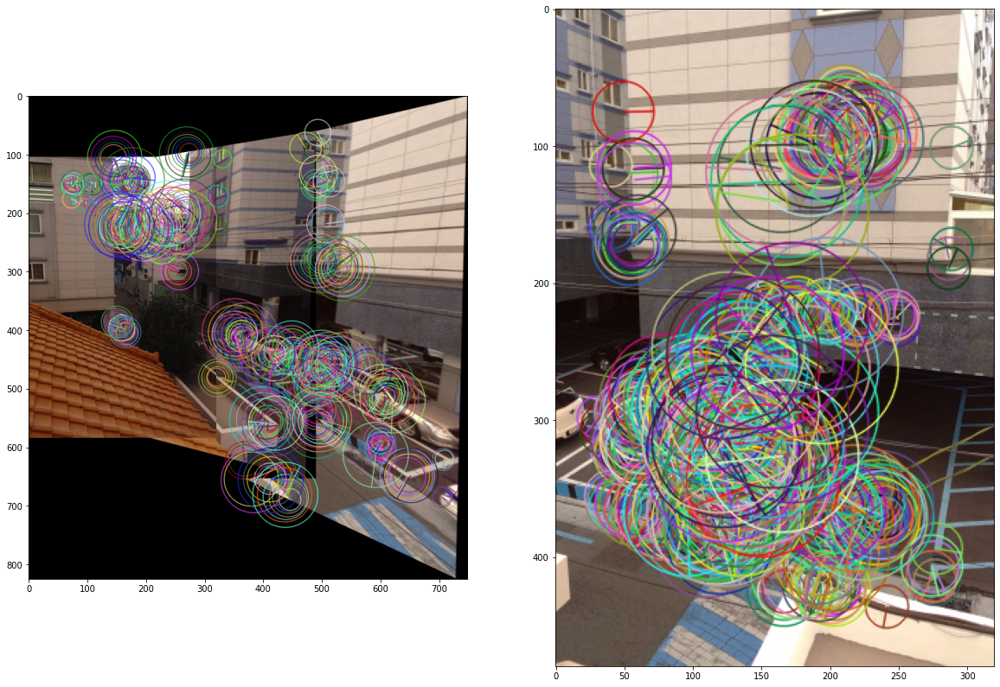

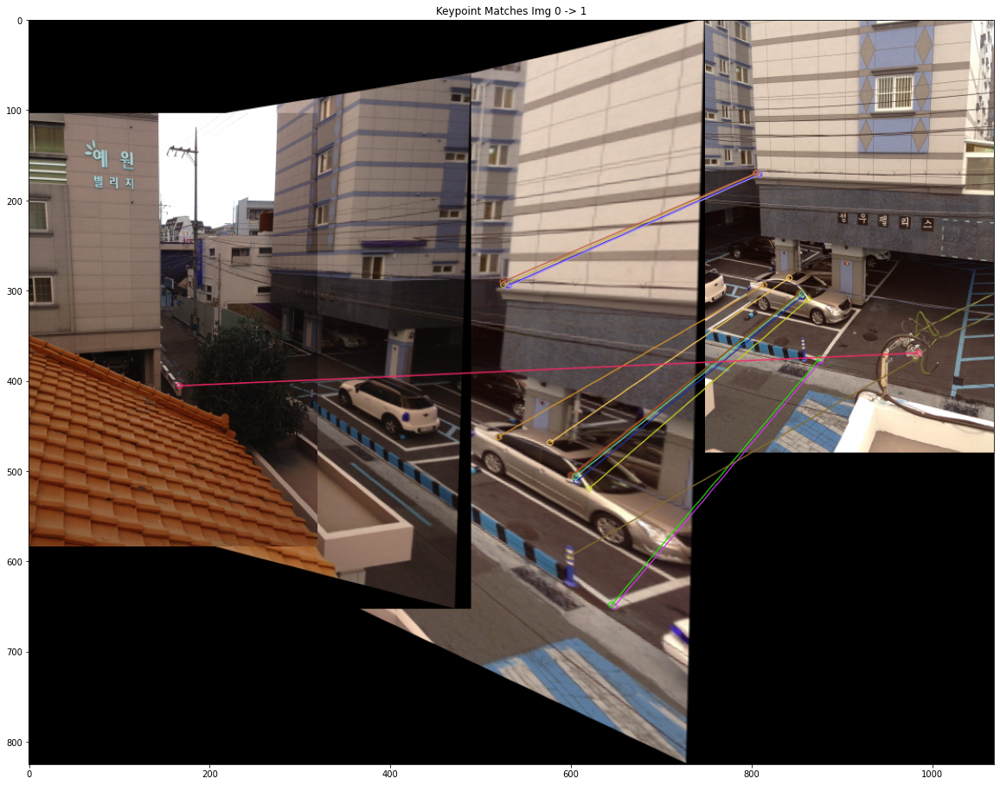

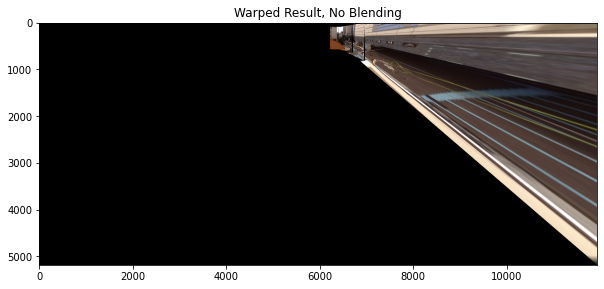

In [ ]:
for i in range(len(imgs)-1):
  if i == 0:
    img1 = imgs[i]
  else:
    img1 = stitched_img

  img2 = imgs[i+1]

  kp1, desc1, kp2, desc2 = feature_detect(img1, img2)

  matches = feature_match(img1, kp1, desc1, img2, kp2, desc2)

  H = compute_homography(kp1, kp2, matches)

  stitched_img = warpTwoImages(img1, img2, np.linalg.inv(H))

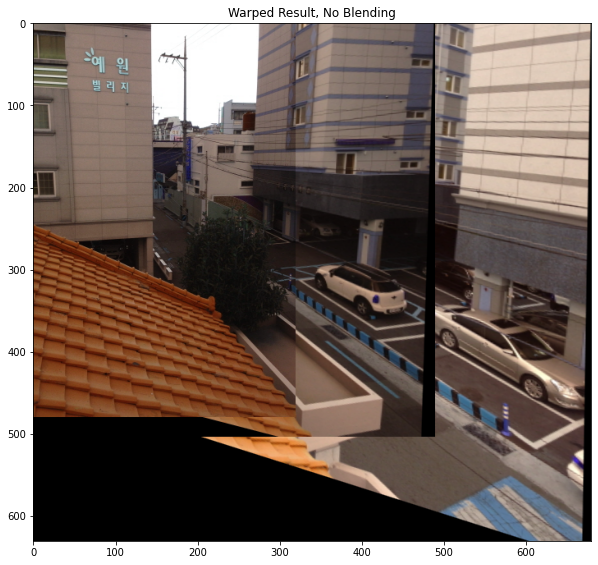

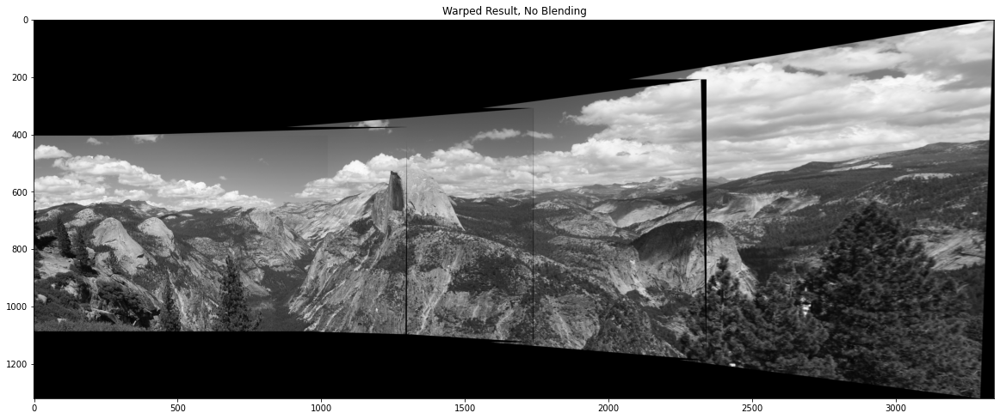

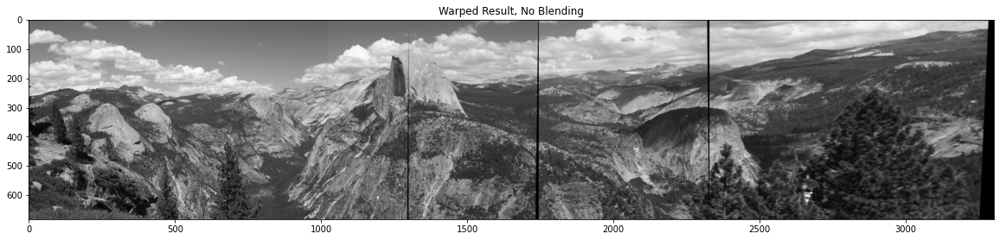

#**Improving the Results - Potential Methods**

The techniques used in this project for image stitching show promising results for some sets of images, but they unfortunately rely on multiple assumptions (i.e. relatively consistent pixel intensity/lighting, untilted camera during panorama, minimal parallax effects, etc.) As we attempt to stitch more images, these assumptions typically become less valid.  \\

Some possible improvements:


*   Bundle Adjustment
*   Automatic Camera Straightening
*   Gain Compensation
*   Multi-Band Blending

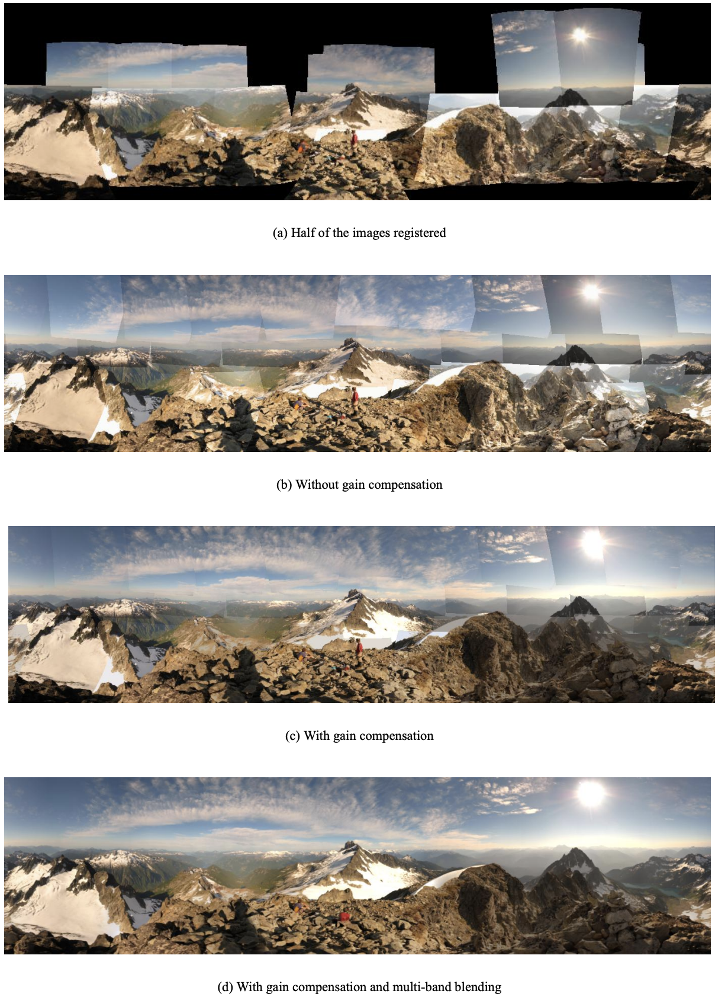